# ML1 - 1.3 Optimization in Relation to Problem Solving Part 1

### This script contains the following:

### Part 1:
#### 1. Importing Libraries
#### 2. Data Cleaning
#### 3a. Gradient Descent (MADRID/1973)
#### 4. Exporting
### Part 2:
#### 1. Importing Libraries
#### 2. Data Cleaning
#### 3b. Graident Descent (OSLO/1997)
#### 3c. Graident Descent (VALENTIA/2022)
#### 3d. Graident Descent (DEBILT/2022)
#### 4. Exporting

### 1. Importing Libraries

In [675]:
# Importing Libraries

import pandas as pd
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import os
from mpl_toolkits import mplot3d

from plotly.offline import download_plotlyjs, init_notebook_mode
from plotly.offline import plot, iplot
import plotly.graph_objects as go

In [676]:
# Importing scaled dataframe as csv

climatewins_scaleddata = pd.read_csv(r'D:\Career Foundry\3) Data Specialization\Machine Learning with Python\Achievement 1 - Basics of Machine Learning for Analysts\ClimateWins\Prepared Python Files\ML1_1.2_W_scaled.cvs')

In [677]:
# Creating Path

path = r'D:\Career Foundry\3) Data Specialization\Machine Learning with Python\Achievement 1 - Basics of Machine Learning for Analysts'

In [678]:
path

'D:\\Career Foundry\\3) Data Specialization\\Machine Learning with Python\\Achievement 1 - Basics of Machine Learning for Analysts'

### 2. Data Cleaning

In [680]:
climatewins_scaleddata.head()

,Unnamed: 0,DATE,MONTH,BASEL_cloud_cover,BASEL_wind_speed,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_snow_depth,...,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_snow_depth,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,0,-1.707663,-1.599964,0.660514,-0.02793,0.826097,-0.001949,-1.101066,-0.265148,-0.179228,...,-0.443701,0.761754,-1.299744,-0.806427,-0.088407,-0.024706,0.372147,-0.668215,-0.519743,-0.752237
1,1,-1.707657,-1.599964,0.244897,-0.02793,0.735760,-0.001949,-1.058108,1.658760,-0.179228,...,0.783085,1.183580,-1.262455,-1.042055,0.503361,-0.024706,-0.829285,-0.548046,-0.629054,-0.407141
2,2,-1.707652,-1.599964,1.076130,-0.02793,1.277781,-0.001949,-1.251420,0.155707,-0.179228,...,0.783085,1.183580,-0.432779,-1.136306,-0.396127,-0.024706,-1.009500,-0.067372,0.054135,-0.177078
3,3,-1.707646,-1.599964,-1.001953,-0.02793,1.458455,-0.001949,-0.821838,-0.445514,-0.179228,...,0.783085,0.480538,0.387574,-1.183432,0.669056,-0.024706,-1.039536,-0.998679,-0.164486,-0.838511
4,4,-1.707641,-1.599964,0.244897,-0.02793,1.729466,-0.001949,-0.746661,-0.164944,-0.179228,...,-1.670486,-0.363113,1.729970,-0.794645,-0.490810,-0.024706,0.672505,-1.509396,-1.339569,-1.471186


In [681]:
climatewins_scaleddata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22950 entries, 0 to 22949
Columns: 171 entries, Unnamed: 0 to VALENTIA_temp_max
dtypes: float64(170), int64(1)
memory usage: 29.9 MB


In [682]:
climatewins_scaleddata.shape

(22950, 171)

In [683]:
climatewins_df=climatewins_scaleddata.drop(columns =['Unnamed: 0'])

In [684]:
climatewins_df.shape

(22950, 170)

In [685]:
# I will import the original data file in order to use the DATE values that are not scaled. In the last exercises I scaled the entire dataset.

In [686]:
# Importing Original dataframe

original_df = pd.read_csv(r'D:\Career Foundry\3) Data Specialization\Machine Learning with Python\Achievement 1 - Basics of Machine Learning for Analysts\ClimateWins\DataSet\ML1 - European Climate Assessment and Data Set Project.csv')

In [687]:
original_df.head()

,DATE,MONTH,BASEL_cloud_cover,BASEL_wind_speed,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_snow_depth,BASEL_sunshine,...,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_snow_depth,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,19600101,1,7,2.1,0.85,1.018,0.32,0.09,0,0.7,...,5,0.88,1.0003,0.45,0.34,0,4.7,8.5,6.0,10.9
1,19600102,1,6,2.1,0.84,1.018,0.36,1.05,0,1.1,...,7,0.91,1.0007,0.25,0.84,0,0.7,8.9,5.6,12.1
2,19600103,1,8,2.1,0.90,1.018,0.18,0.30,0,0.0,...,7,0.91,1.0096,0.17,0.08,0,0.1,10.5,8.1,12.9
3,19600104,1,3,2.1,0.92,1.018,0.58,0.00,0,4.1,...,7,0.86,1.0184,0.13,0.98,0,0.0,7.4,7.3,10.6
4,19600105,1,6,2.1,0.95,1.018,0.65,0.14,0,5.4,...,3,0.80,1.0328,0.46,0.00,0,5.7,5.7,3.0,8.4


In [688]:
original_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22950 entries, 0 to 22949
Columns: 170 entries, DATE to VALENTIA_temp_max
dtypes: float64(145), int64(25)
memory usage: 29.8 MB


In [689]:
# Calling the DATE from the original dataset into the scaled data set

climatewins_df['DATE'] = original_df['DATE']

In [690]:
climatewins_df.head()

,DATE,MONTH,BASEL_cloud_cover,BASEL_wind_speed,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_snow_depth,BASEL_sunshine,...,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_snow_depth,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,19600101,-1.599964,0.660514,-0.02793,0.826097,-0.001949,-1.101066,-0.265148,-0.179228,-0.902918,...,-0.443701,0.761754,-1.299744,-0.806427,-0.088407,-0.024706,0.372147,-0.668215,-0.519743,-0.752237
1,19600102,-1.599964,0.244897,-0.02793,0.735760,-0.001949,-1.058108,1.658760,-0.179228,-0.810126,...,0.783085,1.183580,-1.262455,-1.042055,0.503361,-0.024706,-0.829285,-0.548046,-0.629054,-0.407141
2,19600103,-1.599964,1.076130,-0.02793,1.277781,-0.001949,-1.251420,0.155707,-0.179228,-1.065304,...,0.783085,1.183580,-0.432779,-1.136306,-0.396127,-0.024706,-1.009500,-0.067372,0.054135,-0.177078
3,19600104,-1.599964,-1.001953,-0.02793,1.458455,-0.001949,-0.821838,-0.445514,-0.179228,-0.114186,...,0.783085,0.480538,0.387574,-1.183432,0.669056,-0.024706,-1.039536,-0.998679,-0.164486,-0.838511
4,19600105,-1.599964,0.244897,-0.02793,1.729466,-0.001949,-0.746661,-0.164944,-0.179228,0.187388,...,-1.670486,-0.363113,1.729970,-0.794645,-0.490810,-0.024706,0.672505,-1.509396,-1.339569,-1.471186


In [691]:
climatewins_df.shape

(22950, 170)

In [692]:
# Selecting only mean temperatures

mean_temps_datemonth = climatewins_df[['DATE', 'MONTH','BASEL_temp_mean',
 'BELGRADE_temp_mean',
 'BUDAPEST_temp_mean',
 'DEBILT_temp_mean',
 'DUSSELDORF_temp_mean',
 'GDANSK_temp_mean',
 'HEATHROW_temp_mean',
 'KASSEL_temp_mean',
 'LJUBLJANA_temp_mean',
 'MAASTRICHT_temp_mean',
 'MADRID_temp_mean',
 'MUNCHENB_temp_mean',
 'OSLO_temp_mean',
 'ROMA_temp_mean',
 'SONNBLICK_temp_mean',
 'STOCKHOLM_temp_mean',
 'TOURS_temp_mean',
 'VALENTIA_temp_mean']].copy()

In [693]:
mean_temps_datemonth

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
0,19600101,-1.599964,-0.528623,-1.016876,-1.099163,-0.114356,-0.105836,-0.927601,-0.106469,-0.182904,-1.370824,-0.097084,-0.988280,-0.265742,-0.186575,-1.280450,-0.124331,-0.391072,-0.257321,-0.668215
1,19600102,-1.599964,-0.582946,-1.107669,-1.110927,-0.367511,-0.370915,-0.825294,-0.892676,-0.212437,-1.043881,-0.232112,-0.691740,-0.353714,-0.368598,-0.539569,-0.650834,-0.415953,-0.335759,-0.548046
2,19600103,-1.599964,-0.257010,-1.084971,-1.063873,-0.509912,-0.532908,-0.940389,-0.490837,-0.389635,-0.741156,-0.487164,-0.853490,-0.403983,-0.550620,-0.876333,-0.650834,-0.615003,-0.210258,-0.067372
3,19600104,-1.599964,-0.555784,-1.209812,-1.146217,-0.525734,-0.577088,-1.042696,-0.316124,-0.493001,-0.910682,-0.472161,-0.624345,-0.642763,-0.417137,-0.775304,-0.943336,-0.764290,-0.069069,-0.998679
4,19600105,-1.599964,-1.003946,-1.209812,-1.087400,-0.320045,-0.444548,-0.978754,-0.403481,-0.552067,-0.862246,-0.307127,-0.381721,-0.906678,-0.332193,-0.926848,-0.621584,-0.503037,-0.037694,-1.509396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,20221027,1.013583,0.747959,0.628750,-0.005167,0.898267,1.042841,0.440753,0.906865,-0.005705,0.481853,1.268193,0.683127,0.664244,0.395898,-0.000746,0.826301,0.517090,1.295755,-0.007287
22946,20221028,1.013583,0.856604,0.367720,-0.005167,0.945734,1.278467,0.466330,0.802037,-0.005705,0.263891,1.313202,0.561815,0.890456,0.541516,-0.000746,1.074927,0.641496,1.358505,-0.007287
22947,20221029,1.013583,0.856604,0.083991,-0.005167,0.914089,1.101748,0.786039,0.924336,-0.005705,0.300218,1.208181,0.548336,1.053832,0.395898,-0.000746,1.221178,0.716139,1.405568,-0.007287
22948,20221030,1.013583,0.680055,0.265577,-0.005167,0.692578,0.880848,0.376811,0.697210,-0.005705,0.397090,0.923123,0.103526,0.689378,-0.065226,-0.000746,1.235803,0.019467,0.668249,-0.007287


In [694]:
# Dropping scaled DATE and MONTH from scaled data.

mean_temps_only = mean_temps_datemonth.drop(['DATE','MONTH'], axis=1)

In [695]:
mean_temps_only

,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
0,-0.528623,-1.016876,-1.099163,-0.114356,-0.105836,-0.927601,-0.106469,-0.182904,-1.370824,-0.097084,-0.988280,-0.265742,-0.186575,-1.280450,-0.124331,-0.391072,-0.257321,-0.668215
1,-0.582946,-1.107669,-1.110927,-0.367511,-0.370915,-0.825294,-0.892676,-0.212437,-1.043881,-0.232112,-0.691740,-0.353714,-0.368598,-0.539569,-0.650834,-0.415953,-0.335759,-0.548046
2,-0.257010,-1.084971,-1.063873,-0.509912,-0.532908,-0.940389,-0.490837,-0.389635,-0.741156,-0.487164,-0.853490,-0.403983,-0.550620,-0.876333,-0.650834,-0.615003,-0.210258,-0.067372
3,-0.555784,-1.209812,-1.146217,-0.525734,-0.577088,-1.042696,-0.316124,-0.493001,-0.910682,-0.472161,-0.624345,-0.642763,-0.417137,-0.775304,-0.943336,-0.764290,-0.069069,-0.998679
4,-1.003946,-1.209812,-1.087400,-0.320045,-0.444548,-0.978754,-0.403481,-0.552067,-0.862246,-0.307127,-0.381721,-0.906678,-0.332193,-0.926848,-0.621584,-0.503037,-0.037694,-1.509396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,0.747959,0.628750,-0.005167,0.898267,1.042841,0.440753,0.906865,-0.005705,0.481853,1.268193,0.683127,0.664244,0.395898,-0.000746,0.826301,0.517090,1.295755,-0.007287
22946,0.856604,0.367720,-0.005167,0.945734,1.278467,0.466330,0.802037,-0.005705,0.263891,1.313202,0.561815,0.890456,0.541516,-0.000746,1.074927,0.641496,1.358505,-0.007287
22947,0.856604,0.083991,-0.005167,0.914089,1.101748,0.786039,0.924336,-0.005705,0.300218,1.208181,0.548336,1.053832,0.395898,-0.000746,1.221178,0.716139,1.405568,-0.007287
22948,0.680055,0.265577,-0.005167,0.692578,0.880848,0.376811,0.697210,-0.005705,0.397090,0.923123,0.103526,0.689378,-0.065226,-0.000746,1.235803,0.019467,0.668249,-0.007287


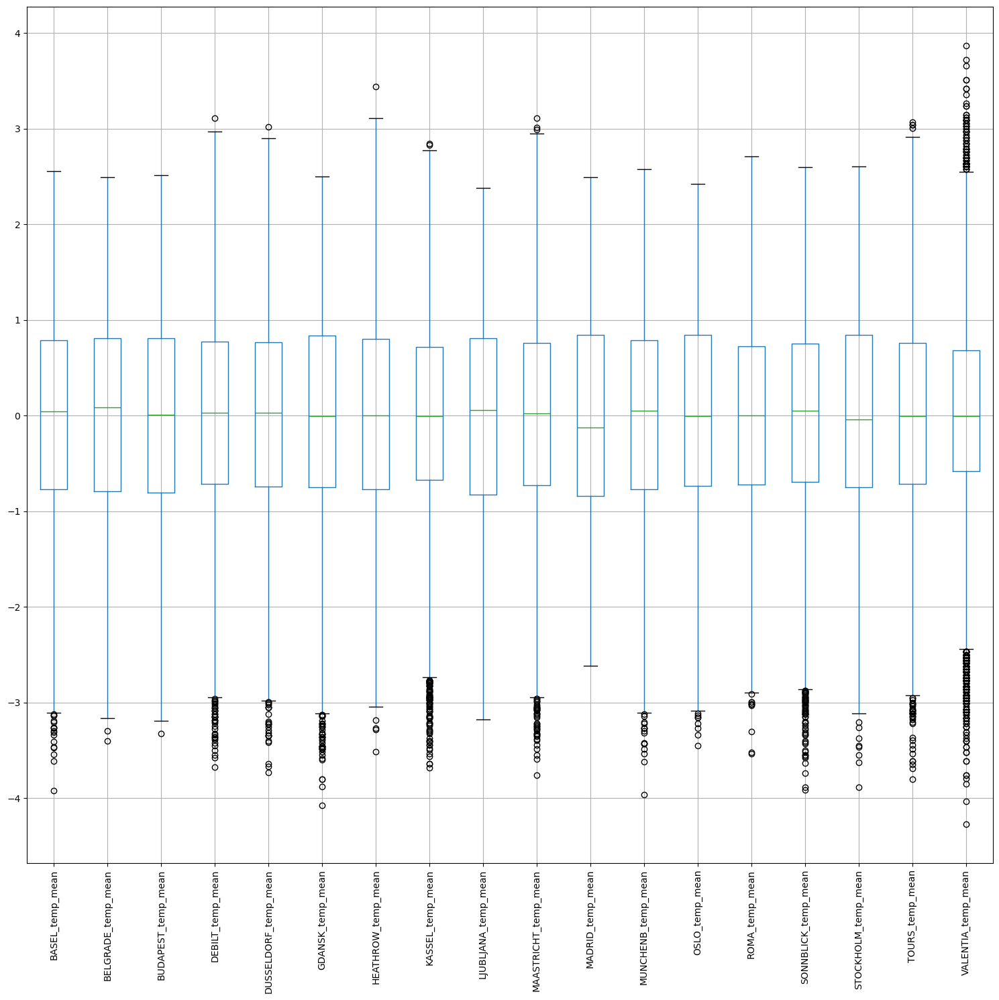

In [696]:
#Look at a whisker plot of the data to see variations in temperatures

mean_temps_only.boxplot(figsize=(15,15))
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig("Whisker plot temperatures.png")
plt.show()

In [697]:
# Reducing dataset to a single year

mean_temps_1973 = mean_temps_datemonth[mean_temps_datemonth['DATE'].astype(str).str.contains('1973')]

In [698]:
mean_temps_1973

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
4749,19730101,-1.599964,-2.199044,-1.130368,-1.510882,-2.013024,-2.005571,-1.720479,-2.045780,-2.383117,-1.491914,-1.717414,-1.365695,-1.333969,-0.320058,-0.556407,-0.431457,-1.062863,-1.512331,-0.037330
4750,19730102,-1.599964,-1.845947,-1.062273,-1.299141,-1.301023,-1.843578,-1.528654,-1.364400,-2.235451,-1.322388,-1.507371,-1.487007,-1.371671,-0.150170,-0.876333,-0.299832,-0.975779,-1.920210,0.052797
4751,19730103,-1.599964,-1.818785,-1.175764,-1.040346,-1.032045,-1.210333,-1.592595,-1.084860,-1.674323,-1.164971,-1.102289,-1.527444,-1.308834,-0.283654,-0.539569,-0.314457,-0.465716,-2.077086,-0.217583
4752,19730104,-1.599964,-1.941011,-1.380049,-1.134453,-1.221912,-1.239786,-0.697411,-0.420952,-1.349460,-1.201298,-1.042277,-1.136550,-1.396806,-0.829722,-0.994201,-0.767835,-0.751849,-1.512331,-0.067372
4753,19730105,-1.599964,-1.655817,-1.414096,-1.405012,-1.538357,-1.283966,-0.774141,-0.892676,-1.378993,-1.128644,-1.552380,-1.392653,-1.434508,0.274550,-1.011039,-1.001836,-0.241785,-1.449581,-0.548046
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5109,19731227,1.594371,-1.085430,-1.039574,-0.958002,-0.557378,-0.694901,-0.761352,-0.630607,-0.965530,-1.177080,-0.787225,-1.271341,-1.057487,-0.793317,-1.364641,-0.884835,-0.577681,-1.198579,-0.157498
5110,19731228,1.594371,-1.261978,-1.221161,-1.263851,-0.462445,-0.635995,-0.607892,-0.333595,-0.788331,-1.346606,-0.757219,-1.244383,-1.095189,-0.659834,-1.246774,-0.782460,-0.391072,-1.512331,-0.848468
5111,19731229,1.594371,-1.397785,-1.187113,-1.040346,-1.126979,-0.709628,-0.671834,-0.386009,-0.699732,-1.455587,-1.027273,-1.257862,-1.233430,-0.538486,-1.398318,-0.606959,-0.590121,-2.092774,-0.007287
5112,19731230,1.594371,-1.574333,-1.221161,-1.099163,-1.475068,-1.195607,-0.786929,-0.525779,-1.319926,-1.334497,-1.432356,-1.298299,-1.535047,-0.332193,-0.842657,-0.168206,-0.266666,-2.061398,-1.118847


In [699]:
mean_temps_1973.describe()

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
count,3.650000e+02,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000
mean,1.973067e+07,0.004762,-0.141816,-0.112209,-0.044034,-0.113055,-0.070775,-0.017736,-0.098810,0.042680,-0.122767,-0.087425,-0.110478,-0.181351,-0.002757,-0.012648,-0.123048,0.008935,-0.126404,0.023825
std,3.454755e+02,1.002610,1.044723,0.988083,1.010864,0.995841,1.021305,0.948992,1.013401,1.104268,0.984906,1.014655,0.971949,1.025278,0.925077,1.214988,1.071326,0.997541,1.078542,1.051019
min,1.973010e+07,-1.599964,-2.945980,-2.390123,-2.487245,-2.740846,-2.756629,-2.449415,-2.045780,-2.826113,-2.509070,-2.962667,-1.716151,-3.206508,-2.261635,-2.290743,-3.195600,-2.505971,-2.296713,-2.350576
25%,1.973040e+07,-0.728781,-1.058269,-1.050924,-0.958002,-0.905467,-0.945254,-0.786929,-0.910147,-0.862164,-1.080208,-0.937255,-0.974801,-1.044919,-0.720508,-1.027877,-0.884835,-0.726968,-0.994640,-0.698257
50%,1.973070e+07,0.142401,-0.202687,-0.086246,0.006597,-0.320045,-0.282556,-0.185876,-0.281182,-0.153371,-0.087270,-0.262118,-0.287368,-0.228040,-0.125901,-0.169128,-0.036580,-0.254226,-0.225946,-0.037330
75%,1.973100e+07,1.013583,0.788701,0.810336,0.865325,0.755867,0.851395,0.798827,0.802037,1.042718,0.796687,0.788095,0.737043,0.764783,0.784213,1.161090,0.782425,0.815664,0.746687,0.833893
max,1.973123e+07,1.594371,1.793669,1.967949,1.724054,2.258979,2.412418,2.090451,2.094911,2.371706,1.559555,2.213385,1.936682,1.707336,1.912755,2.003001,1.952433,2.271212,2.268388,3.117098


In [700]:
# Using the box and whisker plot I'll create 3D models of various weather stations. It will be interesting to see how each 3D model differs.

In [701]:
# Drop MONTH as it is not scaled and not necessary. Keep DATE for my selected year of 1973. My selected weather

climate_1973 = mean_temps_1973.drop('MONTH', axis = 1)

In [702]:
climate_1973.head()

,DATE,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
4749,19730101,-2.199044,-1.130368,-1.510882,-2.013024,-2.005571,-1.720479,-2.045780,-2.383117,-1.491914,-1.717414,-1.365695,-1.333969,-0.320058,-0.556407,-0.431457,-1.062863,-1.512331,-0.037330
4750,19730102,-1.845947,-1.062273,-1.299141,-1.301023,-1.843578,-1.528654,-1.364400,-2.235451,-1.322388,-1.507371,-1.487007,-1.371671,-0.150170,-0.876333,-0.299832,-0.975779,-1.920210,0.052797
4751,19730103,-1.818785,-1.175764,-1.040346,-1.032045,-1.210333,-1.592595,-1.084860,-1.674323,-1.164971,-1.102289,-1.527444,-1.308834,-0.283654,-0.539569,-0.314457,-0.465716,-2.077086,-0.217583
4752,19730104,-1.941011,-1.380049,-1.134453,-1.221912,-1.239786,-0.697411,-0.420952,-1.349460,-1.201298,-1.042277,-1.136550,-1.396806,-0.829722,-0.994201,-0.767835,-0.751849,-1.512331,-0.067372
4753,19730105,-1.655817,-1.414096,-1.405012,-1.538357,-1.283966,-0.774141,-0.892676,-1.378993,-1.128644,-1.552380,-1.392653,-1.434508,0.274550,-1.011039,-1.001836,-0.241785,-1.449581,-0.548046


In [703]:
# Running 3D Surface Plot on Fully scaled temp_mean data - No DATE/MONTH

fig = go.Figure(data=[go.Surface(z=mean_temps_only.values)])
fig.update_layout(title='Temperatures over time - mean_temps_only_all_stations', autosize=False,
                  width=600, height=600)
fig.show()

In [704]:
fig.write_image("Temperatures over time - 3D Surface Plot - mean_temps_only_all_weather_stations.png")

##### I find this 3D Surface Plot a lot interesting. It contains all the temp_mean values for each weather station in year 1973. There are no DATE or MONTH values included. This is incredibly difficult to read as you don't know where each station is positioned let alone the temperatures because the data is scaled. It does leave much to interpret.

### 3a. Gradient Descent (MADRID/1973)

In [707]:
# Plot ALL weather data for all stations for a year 

#X = weather station
#Y = day of the year
#Z = temperature

#you can click/hold in the graph below to rotate!

fig = go.Figure(data=[go.Surface(z=climate_1973.values)])
fig.update_layout(title='Temperatures over time - Climate_1973', autosize=False,
                  width=600, height=600)
fig.show()

In [708]:
fig.write_image("Temperatures over time - 3D Surface Plot - Cliamte_1973.png")

In [709]:
# Showing version of Kaleido I have installed

import kaleido
print(f"kaleido version: {kaleido.__version__}")

kaleido version: 0.1.0.post1


##### CHALLENGE ENCOUNTERED: In Python pip to install kaleido to save images. I restarted the kernel and kept running into an issue where the kernel would freeze after running the fig.write_image() code. After consulting with Gemini AI, I uninstalled kaleido from my Terminal. I then reinstalled the older version of kaleido (0.1.0). Apparently there are issues on Windows where Kaleido gets stuck when communicating with data. My Memory and CPU usage were in sufficient range to have been able to process the image.

In [711]:
# We need to make an index for the year(1973). Create a set of data from 1 to 365 (or to 366 if it's a leap year!)
# 1973 is not a leap year
# We'll scale this by 100 as the index is made. This will help the gradient descent converge 366 = 3.66

i = np.arange(0.01,3.66,0.01) #<---needs to be one GREATER than the total number of days
index = pd.DataFrame(data = i, columns = ['index'])
index

,index
0,0.01
1,0.02
2,0.03
3,0.04
4,0.05
...,...
360,3.61
361,3.62
362,3.63
363,3.64


In [712]:
n_rows = climate_1973.shape[0]
n_rows

365

In [713]:
# This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)

# Represent x_0 as a vector of 1s for vector computation

ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=climate_1973['MADRID_temp_mean'].to_numpy().reshape(n_rows,1)

In [714]:
X.shape, y.shape

((365, 2), (365, 1))

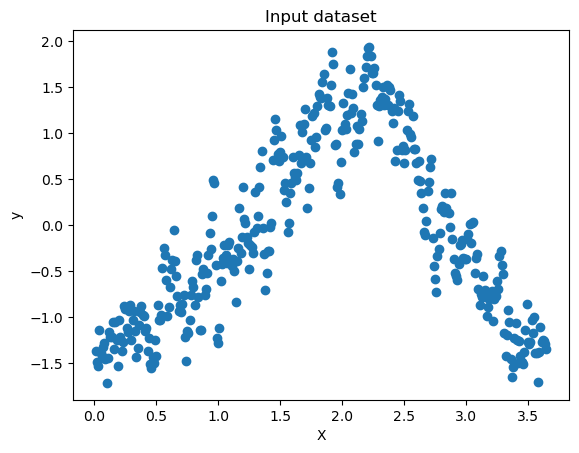

In [715]:
# Look at one year of temperature data over time

plt.scatter(x=index['index'], y=climate_1973['MADRID_temp_mean']) 
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.savefig("Temperature over time - Scatter MADRID1973.png")
plt.show()

In [716]:
# What is the min temperature? (Note gradient descent is not actually finding this number)

climate_1973['MADRID_temp_mean'].min()

-1.7161512693476737

In [717]:
# What is the max temperature? (Note gradient descent is not actually finding this number)
climate_1973['MADRID_temp_mean'].max()

1.9366821017377809

In [718]:
# This computes the loss function for the gradiant descent. We won't change this.

def compute_cost(X, y, theta=np.array([[0],[0]])):
    """Given covariate matrix X, the prediction results y and coefficients theta
    compute the loss"""
    
    m = len(y)
    J=0 # initialize loss to zero
    
    # reshape theta
    theta=theta.reshape(2,1)
    
    # calculate the hypothesis - y_hat
    h_x = np.dot(X,theta)
    #print(h_x)
    
    # subtract y from y_hat, square and sum
    error_term = sum((h_x - y)**2)
    
    # divide by twice the number of samples - standard practice.
    loss = error_term/(2*m)
    
    return loss

In [719]:
compute_cost(X,y)

array([0.47715076])

In [720]:
# This is the gradiant descent function. We will not change this.

def gradient_descent(X, y, theta=np.array([[0],[0]]),
                    alpha=0.01, num_iterations=1500):
    """
    Solve for theta using Gradient Descent optimiztion technique. 
    Alpha is the learning rate
    """
    m = len(y)
    J_history = []
    theta0_history = []
    theta1_history = []
    theta = theta.reshape(2,1)
    
    for i in range(num_iterations):
        error = (np.dot(X, theta) - y)
        
        term0 = (alpha/m) * sum(error* X[:,0].reshape(m,1))
        term1 = (alpha/m) * sum(error* X[:,1].reshape(m,1))
        
        # update theta
        
        term_vector = np.array([[term0],[term1]])
        
        #print(term_vector)
        
        theta = theta - term_vector.reshape(2,1)
        
        # store history values
        
        theta0_history.append(theta[0].tolist()[0])
        theta1_history.append(theta[1].tolist()[0])
        J_history.append(compute_cost(X,y,theta).tolist()[0])
        
    return (theta, J_history, theta0_history, theta1_history)

In [721]:
%%time
# This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
# You will need to adjust these numbers

num_iterations=15 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[-5],[-6]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 0 ns
Wall time: 4.51 ms


In [722]:
theta

array([[-1.60052169],
       [ 0.67960392]])

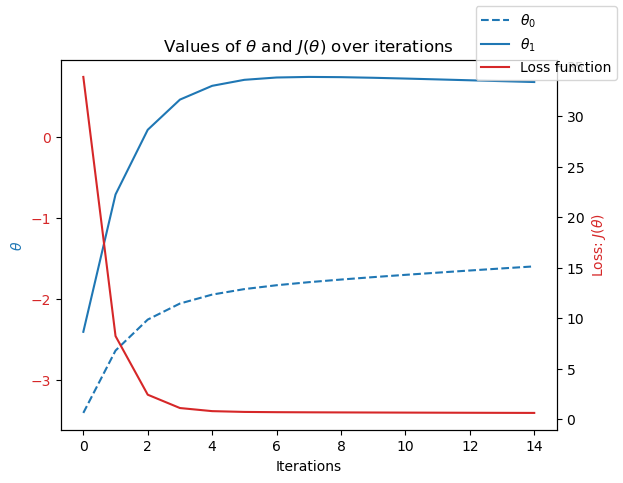

In [723]:
# This will plot your loss, theta0, and theta1. If the result looks like a straight line, it's not converging on an answer!
# Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)

# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time

color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.savefig("Loss Function - MADRID1973.png")
plt.show()

In [724]:
%%time
# theta range
theta0_vals = np.linspace(-2,2,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-2,2,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta

c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.05 s
Wall time: 1.05 s


In [725]:
# This figure shows the loss function.

#X = Theta0
#Y - Theta1
#Z = Loss
# Find where it is closest to 0 in X and Y!

# You can click/hold in the graph below to rotate!

fig = go.Figure(data=[go.Surface(x=theta1_vals, y=theta0_vals, z=J_vals)])
fig.update_layout(title='Loss Function 2 - MADRID1973', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.write_image("Loss Function 2 - MADRID1973.png")
fig.show()

In [726]:
#Here is the same figure as above, with the line the loss function takes toward the minimum.

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss Function 2 - MADRID1973_plots', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.write_image("Loss Function 2 - MADRID1973_plots.png")
fig.show()

##### The closest point to 0 for the X and y points are: X = -0.1414141, y =0.1363636, z =0.01029287 

In [728]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=4 #<---start with the same iterations as above
theta_init=np.array([[-1.14],[0.13]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.1 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

In [729]:
#Let's look at the new loss path on the function. It should start much closer to the goal

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss Function 2 - MADRID1973.2_plots', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.write_image("Loss Function 2 - MADRID1973.2_plots.png")
fig.show()

In [730]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=4 #<---start with the same iterations as above
theta_init=np.array([[0.2],[-0.4]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.1 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

In [731]:
#Let's look at the new loss path on the function. It should start much closer to the goal

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss Function 2 - MADRID1973.3_plots', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.write_image("Loss Function 2 - MADRID1973.3_plots.png")
fig.show()

###### Running the third attempt at the code creating a shorter distance that our plots had to go to reach the closest zero in the 3D model.

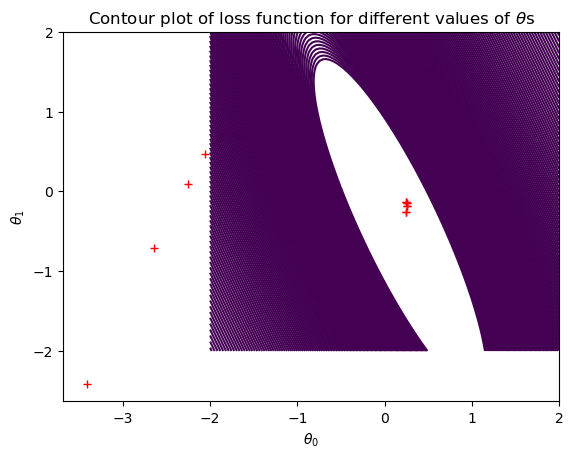

In [733]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,1000))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.savefig("Contour plot of loss function - MADRID1973.png")
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

### 4. Exporting

In [806]:
climatewins_df.to_pickle(os.path.join(path, 'ClimateWins', 'Prepared Python Files', 'ML1_1.3_scaled_og_DATE_column.pkl'))